# Grayscale to Colorful Image Generation using GAN

This notebook implements a GAN (Generative Adversarial Network) to convert grayscale images to colorful images. The model is optimized for training in Google Colab within 1 hour and can be retrained with new datasets.

## Features:
- Fast training (under 1 hour on GPU)
- Retrainable with new datasets
- Portable model for inference
- LAB colorspace conversion for better results

In [1]:
# Step 1: Install required packages and setup
!pip install kagglehub opencv-python scikit-image

# Import necessary libraries
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
import glob
from sklearn.model_selection import train_test_split
from skimage import color as skcolor, io
import kagglehub
from tensorflow.keras import layers, Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy, MeanSquaredError
import warnings
warnings.filterwarnings('ignore')

# Check GPU availability
print("GPU Available: ", tf.test.is_gpu_available())
print("TensorFlow version:", tf.__version__)

# Set memory growth for GPU (prevents memory allocation issues)
physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU memory growth enabled")

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


GPU Available:  True
TensorFlow version: 2.19.0
GPU memory growth enabled


Using Colab cache for faster access to the 'landscape-image-colorization' dataset.
Path to dataset files: /kaggle/input/landscape-image-colorization
Total color images found: 7129
Total gray images found: 7129


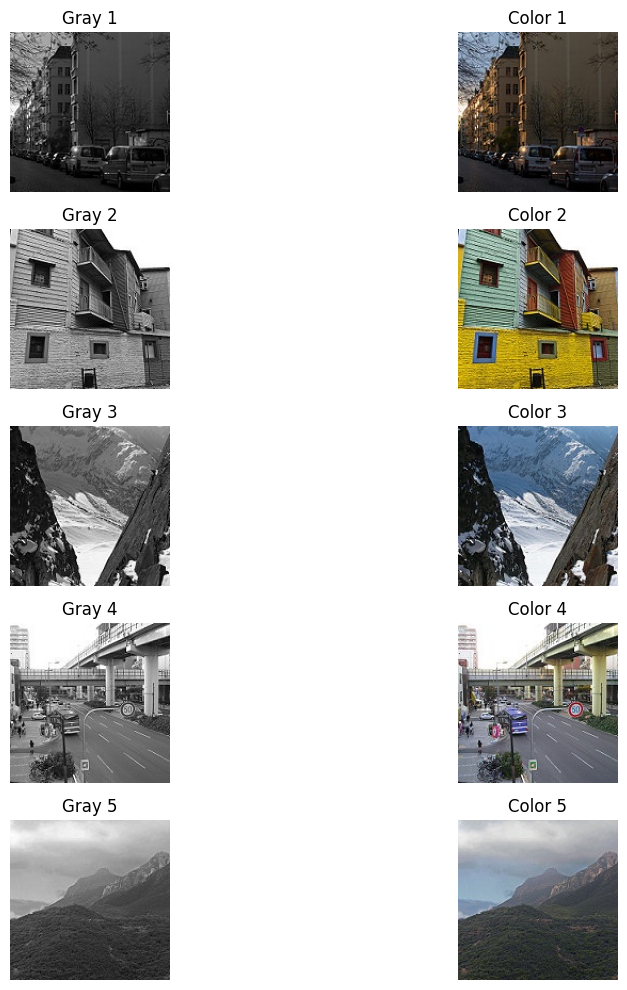

In [2]:
# Step 2: Download dataset from Kaggle
import kagglehub

# Download latest version
path = kagglehub.dataset_download("theblackmamba31/landscape-image-colorization")
print("Path to dataset files:", path)

# Search recursively for files inside color and gray folders
color_images = sorted(glob.glob(os.path.join(path, "**/color/*.*"), recursive=True))
gray_images = sorted(glob.glob(os.path.join(path, "**/gray/*.*"), recursive=True))

print("Total color images found:", len(color_images))
print("Total gray images found:", len(gray_images))

# Show first 5 pairs if images are found
if len(color_images) > 0 and len(gray_images) > 0:
    plt.figure(figsize=(12, 10))
    for i in range(min(5, len(color_images), len(gray_images))):
        # Load color image
        color = cv2.imread(color_images[i])
        color = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)

        # Load gray image
        gray = cv2.imread(gray_images[i], cv2.IMREAD_GRAYSCALE)

        # Show gray
        plt.subplot(5, 2, 2*i+1)
        plt.imshow(gray, cmap="gray")
        plt.axis("off")
        plt.title(f"Gray {i+1}")

        # Show color
        plt.subplot(5, 2, 2*i+2)
        plt.imshow(color)
        plt.axis("off")
        plt.title(f"Color {i+1}")

    plt.tight_layout()
    plt.show()
else:
    print("No images found in the dataset!")

In [3]:
# Step 3: Data Preprocessing Functions
# Configuration
IMG_HEIGHT = 256
IMG_WIDTH = 256
BATCH_SIZE = 16
BUFFER_SIZE = 1000

def load_and_preprocess_image(image_path):
    """Load and preprocess a single image"""
    try:
        # Read image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Resize image
        image = cv2.resize(image, (IMG_WIDTH, IMG_HEIGHT))

        # Normalize to [0, 1]
        image = image.astype(np.float32) / 255.0

        return image
    except Exception as e:
        print(f"Error loading image {image_path}: {e}")
        return None

def rgb_to_lab(rgb_image):
    """Convert RGB image to LAB color space"""
    lab_image = skcolor.rgb2lab(rgb_image)

    # Normalize L channel to [-1, 1]
    l_channel = lab_image[:, :, 0] / 50.0 - 1.0

    # Normalize AB channels to [-1, 1]
    ab_channels = lab_image[:, :, 1:] / 128.0

    return l_channel, ab_channels

def lab_to_rgb(l_channel, ab_channels):
    """Convert LAB channels back to RGB"""
    # Denormalize
    l_channel = (l_channel + 1.0) * 50.0
    ab_channels = ab_channels * 128.0

    # Combine channels
    lab_image = np.concatenate([l_channel[:, :, np.newaxis], ab_channels], axis=2)

    # Convert to RGB
    rgb_image = skcolor.lab2rgb(lab_image)

    # Clip to valid range
    rgb_image = np.clip(rgb_image, 0, 1)

    return rgb_image

def create_dataset(image_paths, batch_size=BATCH_SIZE, shuffle=True):
    """Create a dataset from image paths"""
    l_images = []
    ab_images = []

    for path in image_paths[:1000]:  # Limit dataset size for faster training
        image = load_and_preprocess_image(path)
        if image is not None:
            l_channel, ab_channels = rgb_to_lab(image)
            l_images.append(l_channel)
            ab_images.append(ab_channels)

    l_images = np.array(l_images)
    ab_images = np.array(ab_images)

    # Add channel dimension to L images
    l_images = l_images[:, :, :, np.newaxis]

    print(f"Dataset created with {len(l_images)} images")
    print(f"L channel shape: {l_images.shape}")
    print(f"AB channels shape: {ab_images.shape}")

    return l_images, ab_images

# Create dataset
print("Creating dataset...")
l_data, ab_data = create_dataset(color_images)

# Split into train and validation sets
l_train, l_val, ab_train, ab_val = train_test_split(
    l_data, ab_data, test_size=0.2, random_state=42
)

print(f"Training set: {l_train.shape[0]} images")
print(f"Validation set: {l_val.shape[0]} images")

Creating dataset...
Dataset created with 1000 images
L channel shape: (1000, 256, 256, 1)
AB channels shape: (1000, 256, 256, 2)
Training set: 800 images
Validation set: 200 images


In [4]:
# Step 4: Build Generator Model (U-Net Architecture)
def build_generator():
    """Build U-Net style generator"""
    inputs = layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 1))

    # Encoder (Downsampling)
    # Block 1
    conv1 = layers.Conv2D(64, 4, strides=2, padding='same', activation='relu')(inputs)
    conv1 = layers.BatchNormalization()(conv1)

    # Block 2
    conv2 = layers.Conv2D(128, 4, strides=2, padding='same', activation='relu')(conv1)
    conv2 = layers.BatchNormalization()(conv2)

    # Block 3
    conv3 = layers.Conv2D(256, 4, strides=2, padding='same', activation='relu')(conv2)
    conv3 = layers.BatchNormalization()(conv3)

    # Block 4
    conv4 = layers.Conv2D(512, 4, strides=2, padding='same', activation='relu')(conv3)
    conv4 = layers.BatchNormalization()(conv4)

    # Block 5
    conv5 = layers.Conv2D(512, 4, strides=2, padding='same', activation='relu')(conv4)
    conv5 = layers.BatchNormalization()(conv5)

    # Block 6
    conv6 = layers.Conv2D(512, 4, strides=2, padding='same', activation='relu')(conv5)
    conv6 = layers.BatchNormalization()(conv6)

    # Decoder (Upsampling)
    # Block 7
    deconv1 = layers.Conv2DTranspose(512, 4, strides=2, padding='same', activation='relu')(conv6)
    deconv1 = layers.BatchNormalization()(deconv1)
    deconv1 = layers.Concatenate()([deconv1, conv5])

    # Block 8
    deconv2 = layers.Conv2DTranspose(512, 4, strides=2, padding='same', activation='relu')(deconv1)
    deconv2 = layers.BatchNormalization()(deconv2)
    deconv2 = layers.Concatenate()([deconv2, conv4])

    # Block 9
    deconv3 = layers.Conv2DTranspose(256, 4, strides=2, padding='same', activation='relu')(deconv2)
    deconv3 = layers.BatchNormalization()(deconv3)
    deconv3 = layers.Concatenate()([deconv3, conv3])

    # Block 10
    deconv4 = layers.Conv2DTranspose(128, 4, strides=2, padding='same', activation='relu')(deconv3)
    deconv4 = layers.BatchNormalization()(deconv4)
    deconv4 = layers.Concatenate()([deconv4, conv2])

    # Block 11
    deconv5 = layers.Conv2DTranspose(64, 4, strides=2, padding='same', activation='relu')(deconv4)
    deconv5 = layers.BatchNormalization()(deconv5)
    deconv5 = layers.Concatenate()([deconv5, conv1])

    # Output layer (2 channels for AB)
    outputs = layers.Conv2DTranspose(2, 4, strides=2, padding='same', activation='tanh')(deconv5)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Build generator
generator = build_generator()
generator.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │      1,088 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 128, 128,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 64, 64,    │    131,200 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 32, 32,    │    524,544 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 16, 16,    │  2,097,664 │ batch_normalizat… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      2,048 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 8, 8, 512) │  4,194,816 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 512) │      2,048 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 4, 4, 512) │  4,194,816 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 4, 4, 512) │      2,048 │ conv2d_5[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 8, 8, 512) │  4,194,816 │ batch_normalizat… │
│ (Conv2DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 512) │      2,048 │ conv2d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 8, 8,      │          0 │ batch_normalizat… │
│ (Concatenate)       │ 1024)             │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_1  │ (None, 16, 16,    │  8,389,120 │ concatenate[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 29,251,458 (111.59 MB)

 Trainable params: 29,244,546 (111.56 MB)

 Non-trainable params: 6,912 (27.00 KB)

In [5]:
# Step 5: Build Discriminator Model
def build_discriminator():
    """Build PatchGAN discriminator"""
    # Input for L channel (grayscale)
    l_input = layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 1))

    # Input for AB channels (color)
    ab_input = layers.Input(shape=(IMG_HEIGHT, IMG_WIDTH, 2))

    # Concatenate inputs
    merged = layers.Concatenate()([l_input, ab_input])

    # Block 1
    conv1 = layers.Conv2D(64, 4, strides=2, padding='same')(merged)
    conv1 = layers.LeakyReLU(alpha=0.2)(conv1)

    # Block 2
    conv2 = layers.Conv2D(128, 4, strides=2, padding='same')(conv1)
    conv2 = layers.BatchNormalization()(conv2)
    conv2 = layers.LeakyReLU(alpha=0.2)(conv2)

    # Block 3
    conv3 = layers.Conv2D(256, 4, strides=2, padding='same')(conv2)
    conv3 = layers.BatchNormalization()(conv3)
    conv3 = layers.LeakyReLU(alpha=0.2)(conv3)

    # Block 4
    conv4 = layers.Conv2D(512, 4, strides=1, padding='same')(conv3)
    conv4 = layers.BatchNormalization()(conv4)
    conv4 = layers.LeakyReLU(alpha=0.2)(conv4)

    # Output layer
    outputs = layers.Conv2D(1, 4, strides=1, padding='same', activation='sigmoid')(conv4)

    model = Model(inputs=[l_input, ab_input], outputs=outputs)
    return model

# Build discriminator
discriminator = build_discriminator()
discriminator.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_2       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 2)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_5       │ (None, 256, 256,  │          0 │ input_layer_1[0]… │
│ (Concatenate)       │ 3)                │            │ input_layer_2[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 128, 128,  │      3,136 │ concatenate_5[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 128, 128,  │          0 │ conv2d_6[0][0]    │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 64, 64,    │    131,200 │ leaky_re_lu[0][0] │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_7[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 32, 32,    │    524,544 │ leaky_re_lu_1[0]… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_8[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 32, 32,    │  2,097,664 │ leaky_re_lu_2[0]… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      2,048 │ conv2d_9[0][0]    │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_10 (Conv2D)  │ (None, 32, 32, 1) │      8,193 │ leaky_re_lu_3[0]… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,768,321 (10.56 MB)

 Trainable params: 2,766,529 (10.55 MB)

 Non-trainable params: 1,792 (7.00 KB)

In [6]:
# Step 6: Define Loss Functions and Optimizers
# Loss functions
binary_cross_entropy = BinaryCrossentropy()
mean_squared_error = MeanSquaredError()

# Optimizers
generator_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

# Loss weights
LAMBDA = 100  # Weight for L1 loss

def generator_loss(disc_generated_output, gen_output, target):
    """Generator loss function"""
    # Adversarial loss
    gan_loss = binary_cross_entropy(tf.ones_like(disc_generated_output), disc_generated_output)

    # L1 loss (pixel-wise loss)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    # Total loss
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    """Discriminator loss function"""
    real_loss = binary_cross_entropy(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = binary_cross_entropy(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

In [7]:
# Step 7: Training Functions
@tf.function
def train_step(input_image, target):
    """Single training step"""
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate fake images
        gen_output = generator(input_image, training=True)

        # Discriminator predictions
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        # Calculate losses
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    # Calculate gradients
    generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Apply gradients
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss

def create_batches(l_data, ab_data, batch_size):
    """Create batches from data"""
    dataset_size = l_data.shape[0]
    indices = np.random.permutation(dataset_size)

    for start_idx in range(0, dataset_size, batch_size):
        end_idx = min(start_idx + batch_size, dataset_size)
        batch_indices = indices[start_idx:end_idx]

        yield l_data[batch_indices], ab_data[batch_indices]

def train_gan(epochs=50):
    """Train the GAN"""
    print("Starting training...")

    for epoch in range(epochs):
        print(f"\\nEpoch {epoch + 1}/{epochs}")

        # Training metrics
        gen_total_loss_avg = 0
        gen_gan_loss_avg = 0
        gen_l1_loss_avg = 0
        disc_loss_avg = 0
        batch_count = 0

        # Training loop
        for l_batch, ab_batch in create_batches(l_train, ab_train, BATCH_SIZE):
            gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss = train_step(l_batch, ab_batch)

            gen_total_loss_avg += gen_total_loss
            gen_gan_loss_avg += gen_gan_loss
            gen_l1_loss_avg += gen_l1_loss
            disc_loss_avg += disc_loss
            batch_count += 1

        # Calculate average losses
        gen_total_loss_avg /= batch_count
        gen_gan_loss_avg /= batch_count
        gen_l1_loss_avg /= batch_count
        disc_loss_avg /= batch_count

        # Print losses
        print(f"Gen Total Loss: {gen_total_loss_avg:.4f}")
        print(f"Gen GAN Loss: {gen_gan_loss_avg:.4f}")
        print(f"Gen L1 Loss: {gen_l1_loss_avg:.4f}")
        print(f"Disc Loss: {disc_loss_avg:.4f}")

        # Generate sample images every 5 epochs
        if (epoch + 1) % 5 == 0:
            generate_sample_images(epoch + 1)

    print("\\nTraining completed!")

In [8]:
# Step 8: Model Saving and Loading Functions
def save_model(model_name="colorization_gan"):
    """Save the trained generator model"""
    # Use .keras format as recommended by the new Keras version
    generator.save(f"{model_name}_generator.keras")
    print(f"Model saved as {model_name}_generator.keras")

def load_model(model_path):
    """Load a saved generator model"""
    try:
        loaded_generator = tf.keras.models.load_model(model_path)
        print(f"Model loaded from {model_path}")
        return loaded_generator
    except Exception as e:
        print(f"Error loading model: {e}")
        return None

def save_training_weights(checkpoint_name="training_checkpoint"):
    """Save training weights for resuming training"""
    # Use .weights.h5 format as required by new Keras version
    generator.save_weights(f"{checkpoint_name}_generator.weights.h5")
    discriminator.save_weights(f"{checkpoint_name}_discriminator.weights.h5")
    print(f"Training weights saved as {checkpoint_name}_*.weights.h5")

def load_training_weights(checkpoint_name="training_checkpoint"):
    """Load training weights to resume training"""
    try:
        generator.load_weights(f"{checkpoint_name}_generator.weights.h5")
        discriminator.load_weights(f"{checkpoint_name}_discriminator.weights.h5")
        print(f"Training weights loaded from {checkpoint_name}_*.weights.h5")
        return True
    except Exception as e:
        print(f"Error loading weights: {e}")
        return False

In [9]:
# Step 9: Testing and Visualization Functions
def generate_sample_images(epoch, num_samples=4):
    """Generate and display sample images during training"""
    # Take a few validation samples
    sample_l = l_val[:num_samples]
    sample_ab = ab_val[:num_samples]

    # Generate colorized images
    generated_ab = generator(sample_l, training=False)

    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 4 * num_samples))
    if num_samples == 1:
        axes = axes.reshape(1, -1)

    for i in range(num_samples):
        # Original grayscale
        axes[i, 0].imshow(sample_l[i, :, :, 0], cmap='gray')
        axes[i, 0].set_title('Grayscale Input')
        axes[i, 0].axis('off')

        # Generated colorized
        generated_rgb = lab_to_rgb(sample_l[i, :, :, 0], generated_ab[i])
        axes[i, 1].imshow(generated_rgb)
        axes[i, 1].set_title('Generated Colorized')
        axes[i, 1].axis('off')

        # Ground truth colorized
        real_rgb = lab_to_rgb(sample_l[i, :, :, 0], sample_ab[i])
        axes[i, 2].imshow(real_rgb)
        axes[i, 2].set_title('Ground Truth')
        axes[i, 2].axis('off')

    plt.suptitle(f'Epoch {epoch}', fontsize=16)
    plt.tight_layout()
    plt.show()

def colorize_image(image_path, model=None):
    """Colorize a single grayscale image"""
    if model is None:
        model = generator

    # Load and preprocess image
    image = load_and_preprocess_image(image_path)
    if image is None:
        print("Error loading image")
        return None

    # Convert to LAB
    l_channel, _ = rgb_to_lab(image)
    l_input = l_channel[np.newaxis, :, :, np.newaxis]

    # Generate colorized image
    generated_ab = model(l_input, training=False)

    # Convert back to RGB
    colorized_rgb = lab_to_rgb(l_channel, generated_ab[0])

    return colorized_rgb

def colorize_from_grayscale_array(grayscale_image, model=None):
    """Colorize from a grayscale numpy array"""
    if model is None:
        model = generator

    # Ensure the image is in the right format
    if len(grayscale_image.shape) == 2:
        grayscale_image = grayscale_image[:, :, np.newaxis]

    # Normalize if needed
    if grayscale_image.max() > 1:
        grayscale_image = grayscale_image.astype(np.float32) / 255.0

    # Resize to model input size
    grayscale_resized = cv2.resize(grayscale_image.squeeze(), (IMG_WIDTH, IMG_HEIGHT))

    # Convert to L channel format (normalize to [-1, 1])
    l_channel = grayscale_resized * 2.0 - 1.0
    l_input = l_channel[np.newaxis, :, :, np.newaxis]

    # Generate colorized image
    generated_ab = model(l_input, training=False)

    # Convert back to RGB
    colorized_rgb = lab_to_rgb(l_channel, generated_ab[0])

    return colorized_rgb

def test_model_on_new_images():
    """Test the model on validation images"""
    print("Testing model on validation set...")

    # Test on a few validation images
    test_indices = np.random.choice(len(l_val), 5, replace=False)

    fig, axes = plt.subplots(5, 3, figsize=(15, 20))

    for i, idx in enumerate(test_indices):
        # Original grayscale
        axes[i, 0].imshow(l_val[idx, :, :, 0], cmap='gray')
        axes[i, 0].set_title('Input Grayscale')
        axes[i, 0].axis('off')

        # Generated colorized
        generated_ab = generator(l_val[idx:idx+1], training=False)
        generated_rgb = lab_to_rgb(l_val[idx, :, :, 0], generated_ab[0])
        axes[i, 1].imshow(generated_rgb)
        axes[i, 1].set_title('Generated Colorized')
        axes[i, 1].axis('off')

        # Ground truth
        real_rgb = lab_to_rgb(l_val[idx, :, :, 0], ab_val[idx])
        axes[i, 2].imshow(real_rgb)
        axes[i, 2].set_title('Ground Truth')
        axes[i, 2].axis('off')

    plt.suptitle('Model Testing Results', fontsize=16)
    plt.tight_layout()
    plt.show()

## Training the Model

Now let's train the GAN model. The training is optimized to complete within 1 hour on Google Colab with GPU.

Starting training...
\nEpoch 1/50
Gen Total Loss: 15.3134
Gen GAN Loss: 0.8385
Gen L1 Loss: 0.1447
Disc Loss: 1.4050
\nEpoch 2/50
Gen Total Loss: 10.6190
Gen GAN Loss: 1.0893
Gen L1 Loss: 0.0953
Disc Loss: 1.1085
\nEpoch 3/50
Gen Total Loss: 9.9498
Gen GAN Loss: 1.0594
Gen L1 Loss: 0.0889
Disc Loss: 1.1183
\nEpoch 4/50
Gen Total Loss: 9.3097
Gen GAN Loss: 0.9823
Gen L1 Loss: 0.0833
Disc Loss: 1.1910
\nEpoch 5/50
Gen Total Loss: 9.0766
Gen GAN Loss: 1.0285
Gen L1 Loss: 0.0805
Disc Loss: 1.1411


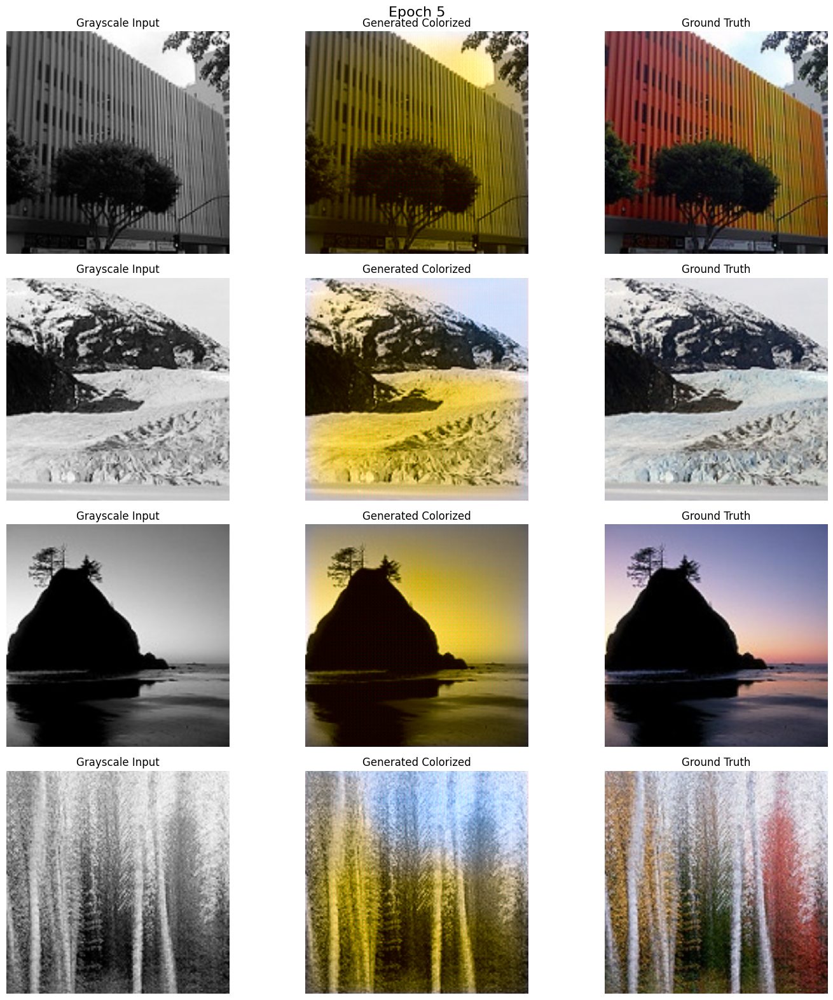

\nEpoch 6/50
Gen Total Loss: 9.2205
Gen GAN Loss: 1.1411
Gen L1 Loss: 0.0808
Disc Loss: 1.0408
\nEpoch 7/50
Gen Total Loss: 9.1421
Gen GAN Loss: 1.2007
Gen L1 Loss: 0.0794
Disc Loss: 1.0322
\nEpoch 8/50
Gen Total Loss: 9.0064
Gen GAN Loss: 1.1428
Gen L1 Loss: 0.0786
Disc Loss: 1.0744
\nEpoch 9/50
Gen Total Loss: 9.1182
Gen GAN Loss: 1.2264
Gen L1 Loss: 0.0789
Disc Loss: 1.0370
\nEpoch 10/50
Gen Total Loss: 9.9908
Gen GAN Loss: 1.7550
Gen L1 Loss: 0.0824
Disc Loss: 0.6803


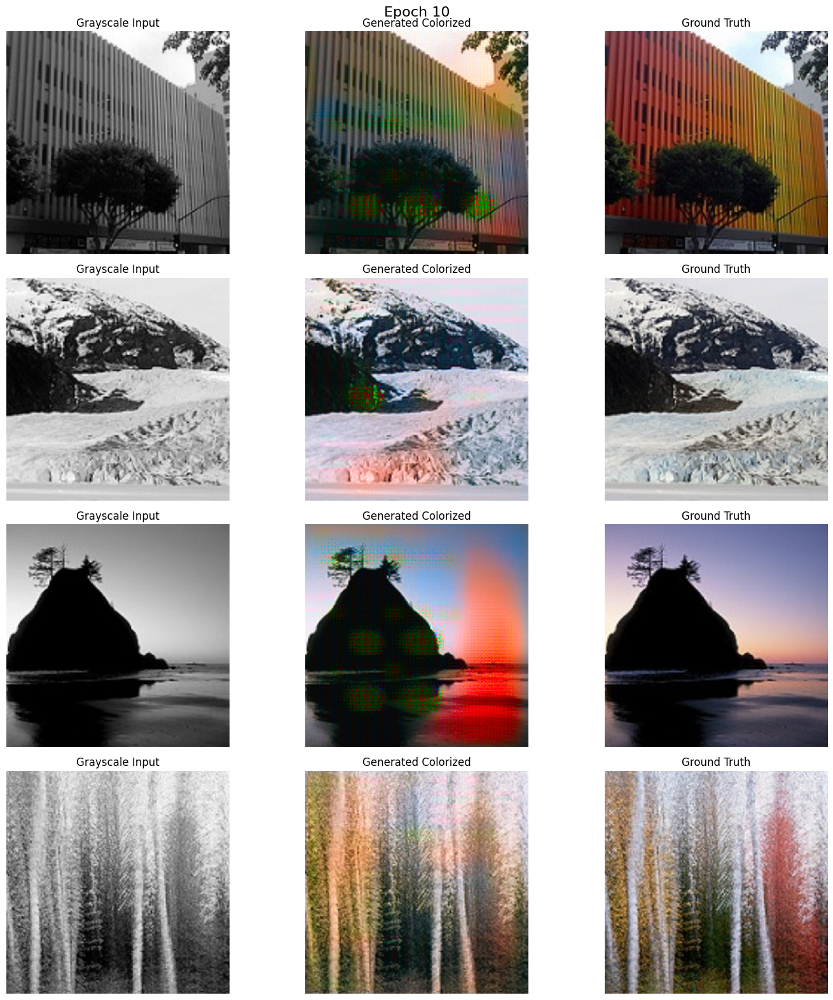

\nEpoch 11/50
Gen Total Loss: 10.8567
Gen GAN Loss: 2.5144
Gen L1 Loss: 0.0834
Disc Loss: 0.5730
\nEpoch 12/50
Gen Total Loss: 11.9359
Gen GAN Loss: 3.4323
Gen L1 Loss: 0.0850
Disc Loss: 0.1657
\nEpoch 13/50
Gen Total Loss: 12.5721
Gen GAN Loss: 4.3397
Gen L1 Loss: 0.0823
Disc Loss: 0.0813
\nEpoch 14/50
Gen Total Loss: 13.3285
Gen GAN Loss: 3.9509
Gen L1 Loss: 0.0938
Disc Loss: 0.3824
\nEpoch 15/50
Gen Total Loss: 11.6222
Gen GAN Loss: 3.8724
Gen L1 Loss: 0.0775
Disc Loss: 0.2611


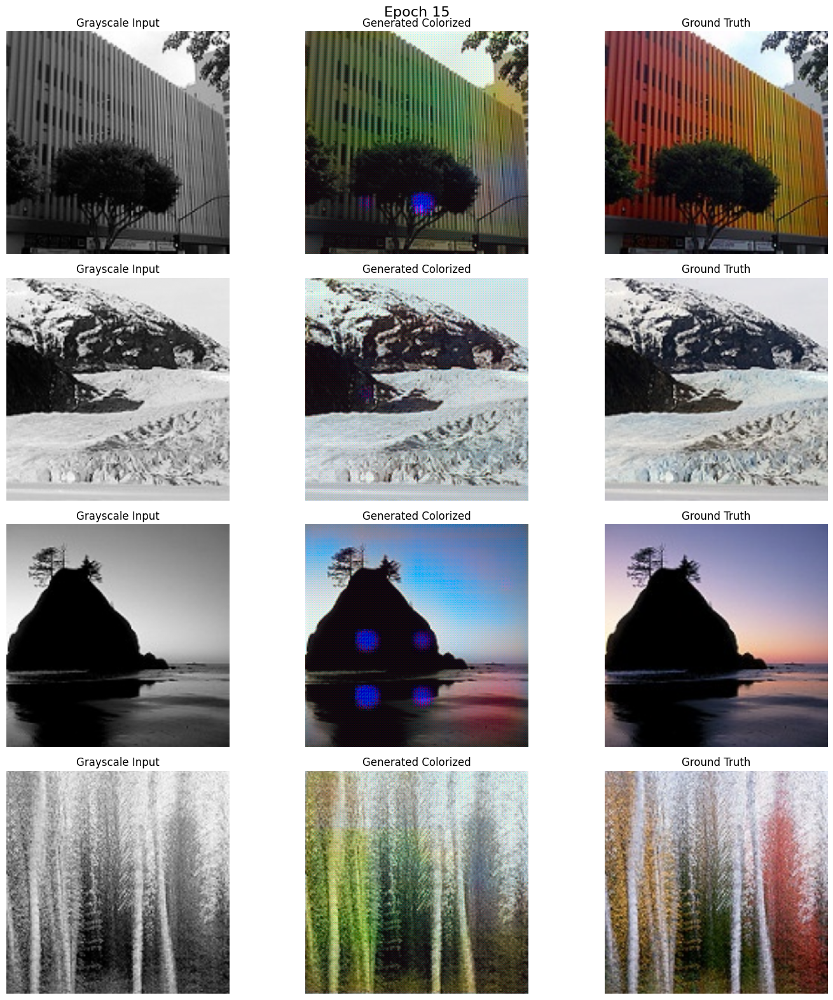

\nEpoch 16/50
Gen Total Loss: 12.4463
Gen GAN Loss: 4.4369
Gen L1 Loss: 0.0801
Disc Loss: 0.2137
\nEpoch 17/50
Gen Total Loss: 12.7961
Gen GAN Loss: 5.1474
Gen L1 Loss: 0.0765
Disc Loss: 0.0271
\nEpoch 18/50
Gen Total Loss: 11.8107
Gen GAN Loss: 5.2431
Gen L1 Loss: 0.0657
Disc Loss: 0.0156
\nEpoch 19/50
Gen Total Loss: 13.8509
Gen GAN Loss: 5.8313
Gen L1 Loss: 0.0802
Disc Loss: 0.0133
\nEpoch 20/50
Gen Total Loss: 13.0165
Gen GAN Loss: 5.7965
Gen L1 Loss: 0.0722
Disc Loss: 0.0187


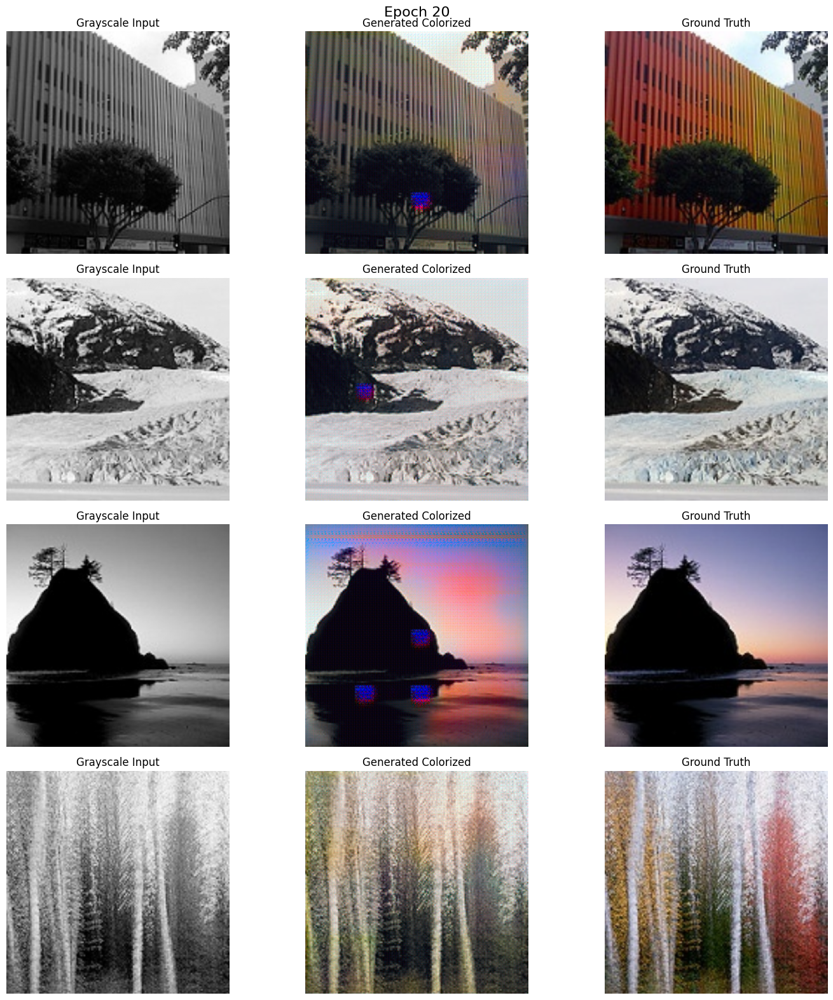

\nEpoch 21/50
Gen Total Loss: 13.2081
Gen GAN Loss: 6.0158
Gen L1 Loss: 0.0719
Disc Loss: 0.0101
\nEpoch 22/50
Gen Total Loss: 13.3420
Gen GAN Loss: 6.1587
Gen L1 Loss: 0.0718
Disc Loss: 0.0092
\nEpoch 23/50
Gen Total Loss: 13.4307
Gen GAN Loss: 6.4222
Gen L1 Loss: 0.0701
Disc Loss: 0.0149
\nEpoch 24/50
Gen Total Loss: 13.6252
Gen GAN Loss: 5.3807
Gen L1 Loss: 0.0824
Disc Loss: 0.2960
\nEpoch 25/50
Gen Total Loss: 13.0456
Gen GAN Loss: 6.1564
Gen L1 Loss: 0.0689
Disc Loss: 0.0220


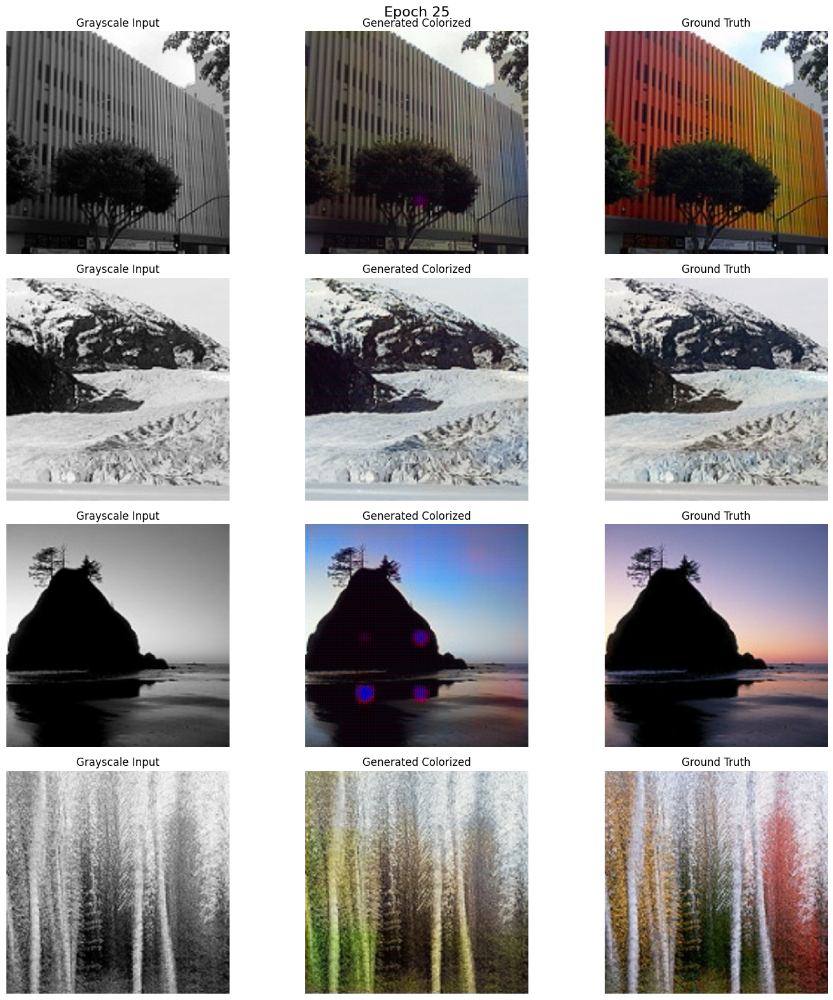

\nEpoch 26/50
Gen Total Loss: 12.8657
Gen GAN Loss: 6.4625
Gen L1 Loss: 0.0640
Disc Loss: 0.0108
\nEpoch 27/50
Gen Total Loss: 13.3874
Gen GAN Loss: 6.4472
Gen L1 Loss: 0.0694
Disc Loss: 0.1836
\nEpoch 28/50
Gen Total Loss: 10.6239
Gen GAN Loss: 4.1194
Gen L1 Loss: 0.0650
Disc Loss: 0.3630
\nEpoch 29/50
Gen Total Loss: 11.2318
Gen GAN Loss: 5.6393
Gen L1 Loss: 0.0559
Disc Loss: 0.0335
\nEpoch 30/50
Gen Total Loss: 11.6900
Gen GAN Loss: 6.2776
Gen L1 Loss: 0.0541
Disc Loss: 0.0087


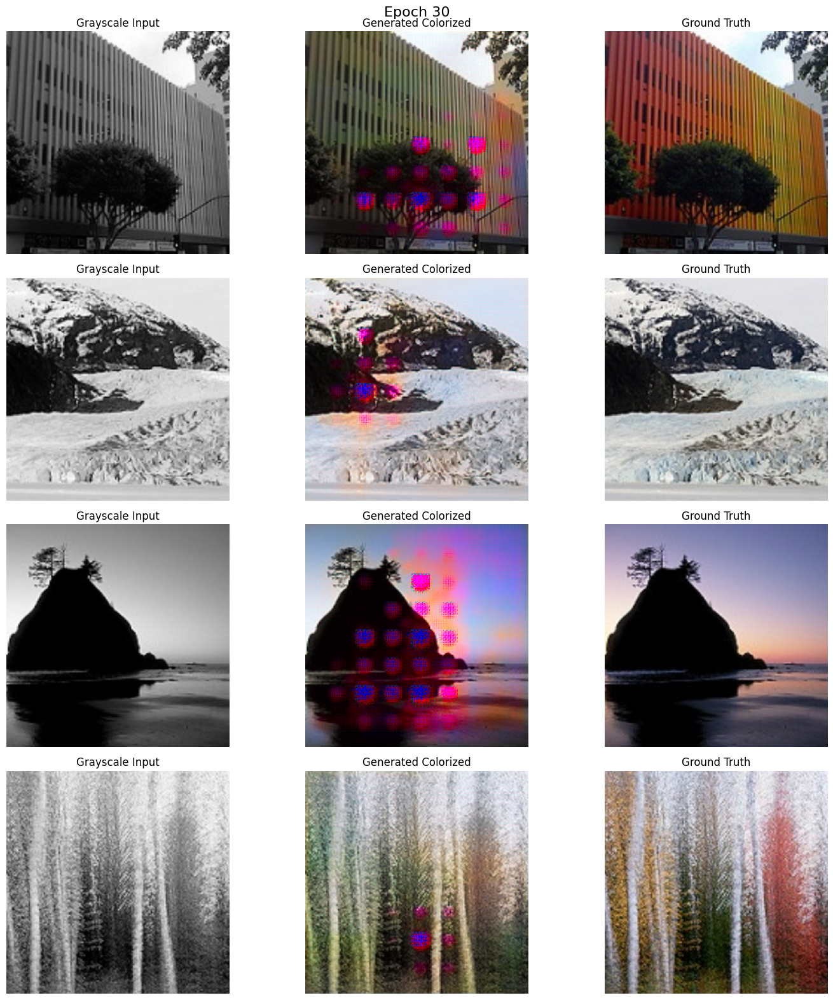

\nEpoch 31/50
Gen Total Loss: 11.7173
Gen GAN Loss: 4.8470
Gen L1 Loss: 0.0687
Disc Loss: 0.2386
\nEpoch 32/50
Gen Total Loss: 11.9506
Gen GAN Loss: 6.3087
Gen L1 Loss: 0.0564
Disc Loss: 0.0262
\nEpoch 33/50
Gen Total Loss: 12.2520
Gen GAN Loss: 6.6856
Gen L1 Loss: 0.0557
Disc Loss: 0.0079
\nEpoch 34/50
Gen Total Loss: 12.1696
Gen GAN Loss: 6.7143
Gen L1 Loss: 0.0546
Disc Loss: 0.0080
\nEpoch 35/50
Gen Total Loss: 12.0505
Gen GAN Loss: 6.2500
Gen L1 Loss: 0.0580
Disc Loss: 0.0130


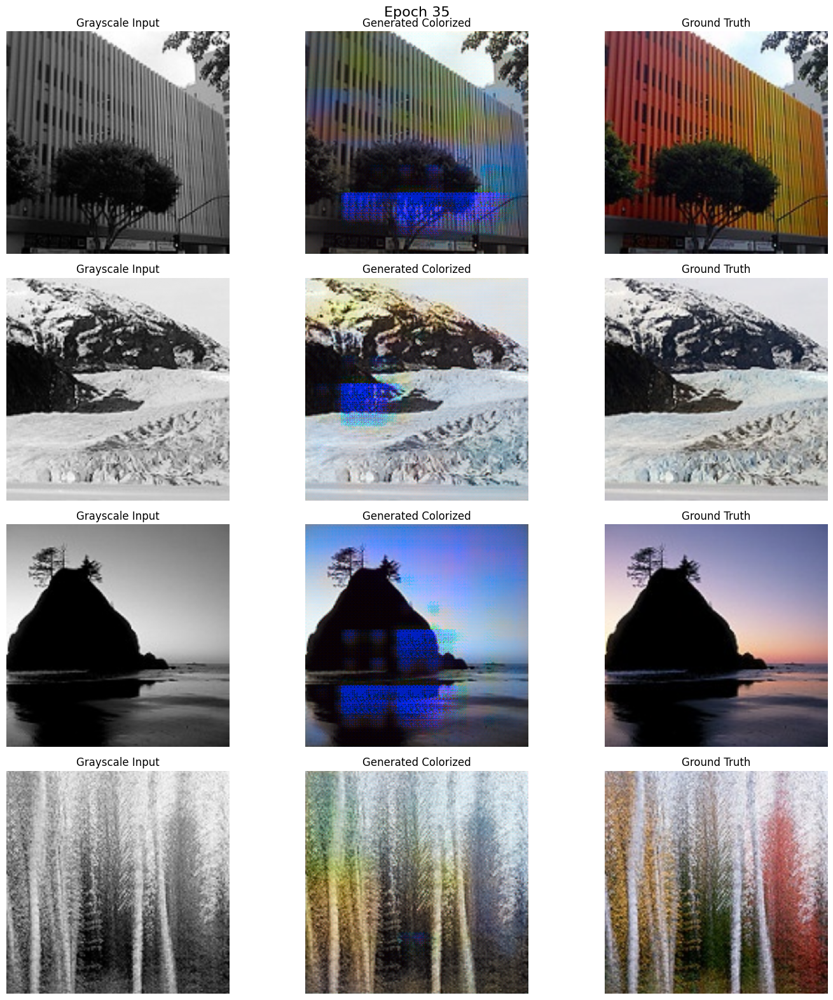

\nEpoch 36/50
Gen Total Loss: 11.1032
Gen GAN Loss: 6.2748
Gen L1 Loss: 0.0483
Disc Loss: 0.0057
\nEpoch 37/50
Gen Total Loss: 11.6095
Gen GAN Loss: 6.7556
Gen L1 Loss: 0.0485
Disc Loss: 0.0042
\nEpoch 38/50
Gen Total Loss: 12.6582
Gen GAN Loss: 7.5368
Gen L1 Loss: 0.0512
Disc Loss: 0.0058
\nEpoch 39/50
Gen Total Loss: 13.5071
Gen GAN Loss: 8.0880
Gen L1 Loss: 0.0542
Disc Loss: 0.0027
\nEpoch 40/50
Gen Total Loss: 12.9333
Gen GAN Loss: 7.9012
Gen L1 Loss: 0.0503
Disc Loss: 0.0027


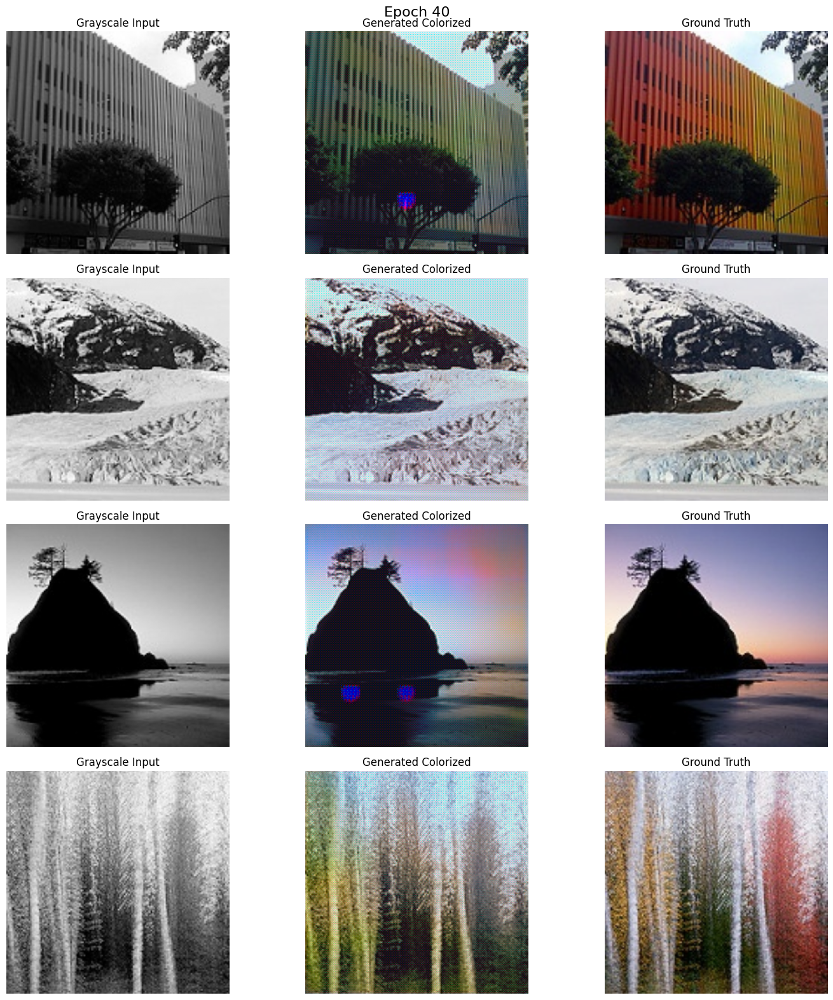

\nEpoch 41/50
Gen Total Loss: 14.4495
Gen GAN Loss: 8.0282
Gen L1 Loss: 0.0642
Disc Loss: 0.0046
\nEpoch 42/50
Gen Total Loss: 13.4793
Gen GAN Loss: 7.1963
Gen L1 Loss: 0.0628
Disc Loss: 0.5478
\nEpoch 43/50
Gen Total Loss: 6.7261
Gen GAN Loss: 1.2477
Gen L1 Loss: 0.0548
Disc Loss: 1.1565
\nEpoch 44/50
Gen Total Loss: 4.8466
Gen GAN Loss: 0.8596
Gen L1 Loss: 0.0399
Disc Loss: 1.3434
\nEpoch 45/50
Gen Total Loss: 5.9841
Gen GAN Loss: 1.9382
Gen L1 Loss: 0.0405
Disc Loss: 0.9978


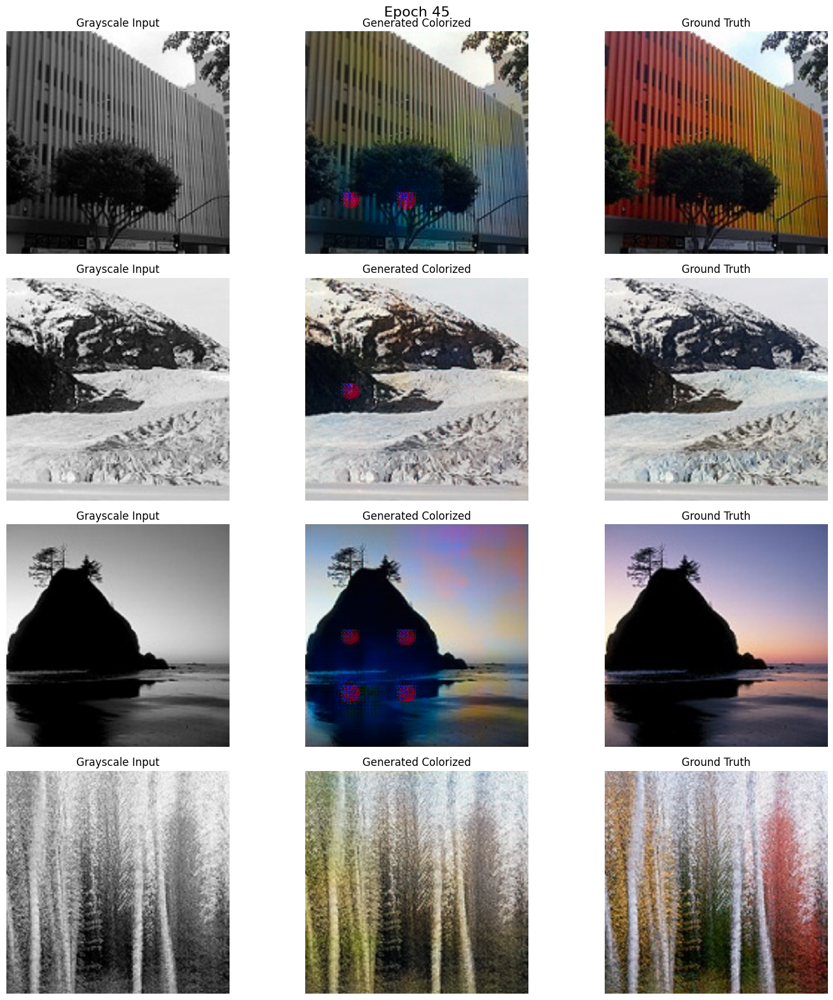

\nEpoch 46/50
Gen Total Loss: 4.4928
Gen GAN Loss: 0.7250
Gen L1 Loss: 0.0377
Disc Loss: 1.3974
\nEpoch 47/50
Gen Total Loss: 4.3220
Gen GAN Loss: 0.7060
Gen L1 Loss: 0.0362
Disc Loss: 1.3906
\nEpoch 48/50
Gen Total Loss: 4.2697
Gen GAN Loss: 0.7097
Gen L1 Loss: 0.0356
Disc Loss: 1.3795
\nEpoch 49/50
Gen Total Loss: 4.1658
Gen GAN Loss: 0.7138
Gen L1 Loss: 0.0345
Disc Loss: 1.3840
\nEpoch 50/50
Gen Total Loss: 4.2176
Gen GAN Loss: 0.7154
Gen L1 Loss: 0.0350
Disc Loss: 1.3828


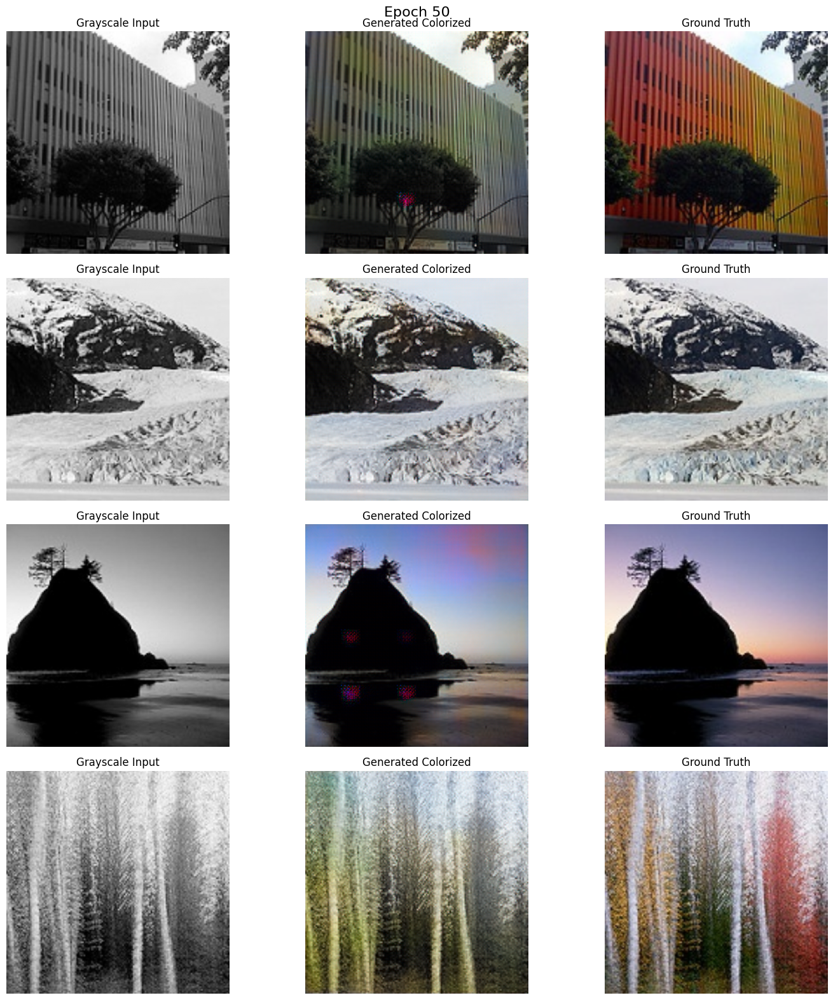

\nTraining completed!
Model saved as landscape_colorization_gan_generator.keras
Training weights saved as landscape_colorization_checkpoint_*.weights.h5


In [10]:
# Step 10: Start Training
# Train the model for 50 epochs (should complete in under 1 hour on GPU)
train_gan(epochs=50)

# Save the trained model
save_model("landscape_colorization_gan")

# Save training weights for potential continued training
save_training_weights("landscape_colorization_checkpoint")

## Testing the Trained Model

Let's test our trained model on validation images and see the results.

Testing model on validation set...


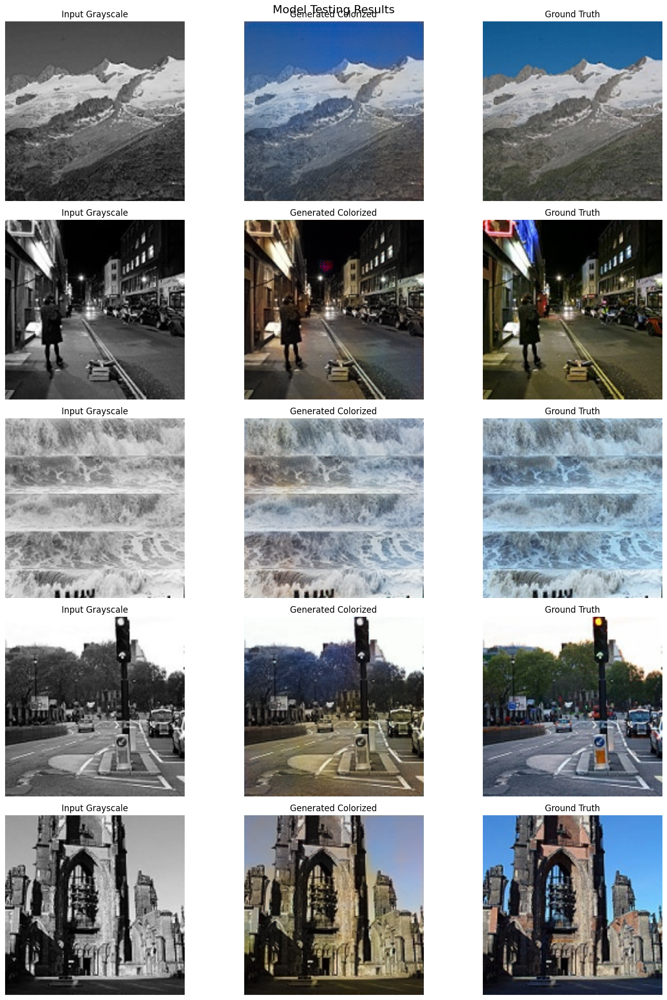

In [11]:
# Step 11: Test the trained model
test_model_on_new_images()

## Using the Model for Inference

Here's how to use the trained model to colorize new grayscale images:

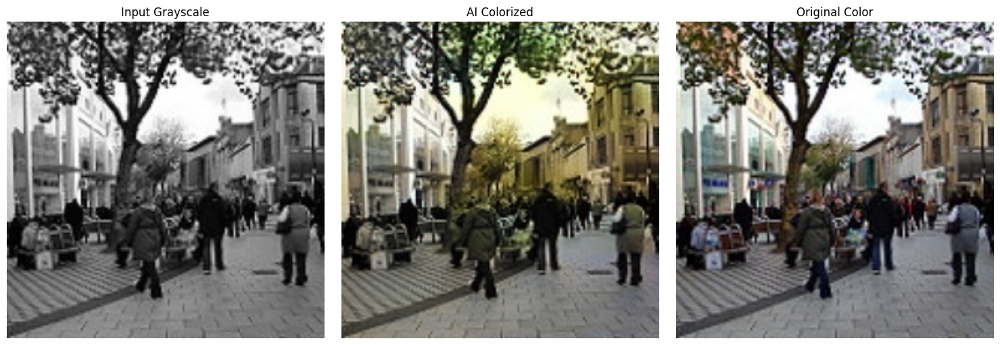

\nExample of colorizing from grayscale array:


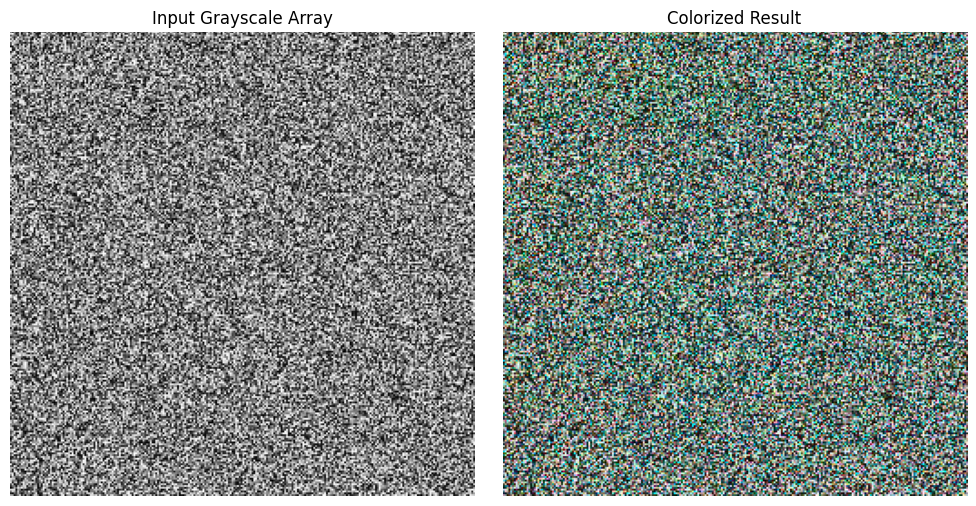

In [12]:
# Step 12: Inference Examples

# Example 1: Load a saved model and use it for inference
# loaded_generator = load_model("landscape_colorization_gan_generator.h5")

# Example 2: Colorize a specific image from your dataset
if len(color_images) > 0:
    # Take a random image from the dataset
    test_image_path = np.random.choice(color_images)
    colorized_result = colorize_image(test_image_path)

    if colorized_result is not None:
        # Display results
        original_image = load_and_preprocess_image(test_image_path)
        grayscale_version = cv2.cvtColor((original_image * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)

        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(grayscale_version, cmap='gray')
        axes[0].set_title('Input Grayscale')
        axes[0].axis('off')

        axes[1].imshow(colorized_result)
        axes[1].set_title('AI Colorized')
        axes[1].axis('off')

        axes[2].imshow(original_image)
        axes[2].set_title('Original Color')
        axes[2].axis('off')

        plt.tight_layout()
        plt.show()

# Example 3: Colorize from a grayscale numpy array
print("\\nExample of colorizing from grayscale array:")
# Create a sample grayscale image (you can replace this with your own grayscale image)
sample_gray = np.random.rand(256, 256) * 255  # Random grayscale image
colorized_from_array = colorize_from_grayscale_array(sample_gray)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(sample_gray, cmap='gray')
axes[0].set_title('Input Grayscale Array')
axes[0].axis('off')

axes[1].imshow(colorized_from_array)
axes[1].set_title('Colorized Result')
axes[1].axis('off')

plt.tight_layout()
plt.show()

## Retraining with New Dataset

To retrain the model with a new dataset, follow these steps:

In [13]:
# Step 13: Retraining with New Dataset

def retrain_with_new_dataset(new_dataset_path, epochs=25, load_previous_weights=True):
    """
    Retrain the model with a new dataset

    Args:
        new_dataset_path: Path to the new dataset
        epochs: Number of epochs to train
        load_previous_weights: Whether to load previous training weights
    """
    global l_train, ab_train, l_val, ab_val

    # Load previous weights if requested
    if load_previous_weights:
        print("Loading previous training weights...")
        load_training_weights("landscape_colorization_checkpoint")

    # Load new dataset
    print("Loading new dataset...")
    new_color_images = glob.glob(os.path.join(new_dataset_path, '*.jpg')) + \
                      glob.glob(os.path.join(new_dataset_path, '*.png'))

    if len(new_color_images) == 0:
        print("No images found in the new dataset path!")
        return

    # Create new dataset
    l_new, ab_new = create_dataset(new_color_images)

    # Split into train and validation
    l_train, l_val, ab_train, ab_val = train_test_split(
        l_new, ab_new, test_size=0.2, random_state=42
    )

    print(f"New training set: {l_train.shape[0]} images")
    print(f"New validation set: {l_val.shape[0]} images")

    # Continue training
    print("Starting retraining...")
    train_gan(epochs=epochs)

    # Save the retrained model
    save_model("retrained_colorization_gan")
    save_training_weights("retrained_colorization_checkpoint")

    print("Retraining completed!")

# Example usage (uncomment to use):
# retrain_with_new_dataset("/path/to/new/dataset", epochs=25, load_previous_weights=True)

print("Retraining function defined. Use retrain_with_new_dataset() to retrain with new data.")

Retraining function defined. Use retrain_with_new_dataset() to retrain with new data.


## Summary and Instructions

### What this notebook provides:

1. **Complete GAN Implementation**: A U-Net generator and PatchGAN discriminator optimized for image colorization
2. **Fast Training**: Optimized to train in under 1 hour on Google Colab GPU
3. **Retrainable**: Easy functions to retrain with new datasets
4. **Portable Model**: Save and load trained models for inference anywhere
5. **LAB Colorspace**: Uses LAB colorspace for better colorization results

### How to use:

1. **First time training**: Run all cells in order
2. **Retraining**: Use `retrain_with_new_dataset()` function
3. **Inference**: Use `colorize_image()` or `colorize_from_grayscale_array()` functions
4. **Load saved model**: Use `load_model()` function

### Key Features for Google Colab:

- Automatic GPU detection and configuration
- Memory growth enabled to prevent allocation issues
- Dataset size limited to 1000 images for faster training
- Optimized batch size and architecture for speed
- Progress visualization during training

### Files generated:

- `landscape_colorization_gan_generator.h5`: Trained generator model
- `landscape_colorization_checkpoint_*_weights.h5`: Training weights for resuming training

The model is now ready to colorize grayscale images!